In [ ]:
! pip install scienceplots

In [ ]:
#importing required libraries
import numpy as np
import scienceplots
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy.integrate import solve_ivp
from matplotlib import animation
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import PillowWriter
from IPython.display import Image,display

mpl.rcParams['font.size'] = 18  # Adjusting plot parameters
mpl.rcParams['axes.labelsize'] = 18
mpl.rcParams['xtick.labelsize'] = 18
mpl.rcParams['ytick.labelsize'] = 18
mpl.rcParams['legend.fontsize'] = 18
mpl.rcParams['figure.titlesize'] = 14
plt.style.use(['science','no-latex'])

In [ ]:
# initial conditions

m1 = 1
m2 = 1
m3 = m2
x1_0 = -1
y1_0 = 0
x2_0 = 1
y2_0 = 0
x3_0 = 0
y3_0 = 0

Newton's law of gravitation is given by:

$$
F = ma = \frac{GMm}{r^2}
$$

For a collection of masses, this can be written in terms of:

$$
\frac{d^2 \vec{r_i}}{dt^2} = \sum_{j \neq i} \frac{G m_j}{r_{ij^3}} \vec{r}_{ij}
$$

Non-dimensionalize the system
$$
   \vec{r_i}' = \frac{\vec{r_i}}{L}, \quad \vec{r_{ij}}' = \frac{r_{ij}}{L}$$


$$ m_i' = \frac{m_i}{M}$$

$$
   t' = t \sqrt{\frac{GM}{L^3}}
$$

   
   where $L$ , $M$, $t'$ are a characteristic length, mass , time of the problem.
Substituting these dimensionless quantities into the original equation gives:

$$
\frac{d^2 \vec{r}'_i}{d t'^2} = \sum_{j \neq i} \frac{m'_j}{r'^3_{ij}} \vec{r}'_{ij}
$$

In [ ]:
# Define the system
def dSdt(t, S):
    x1, y1, x2, y2, x3, y3, vx1, vy1, vx2, vy2, vx3, vy3 = S
    r12 = np.sqrt((x2-x1)**2 + (y2-y1)**2)
    r13 = np.sqrt((x3-x1)**2 + (y3-y1)**2)
    r23 = np.sqrt((x2-x3)**2 + (y2-y3)**2)
    return [ vx1,
            vy1,
            vx2,
            vy2,
            vx3,
            vy3,
            m2/r12**3 * (x2-x1) + m3/r13**3 * (x3-x1), #mass 1
            m2/r12**3 * (y2-y1) + m3/r13**3 * (y3-y1),
            m1/r12**3 * (x1-x2) + m3/r23**3 * (x3-x2), #mass 2
            m1/r12**3 * (y1-y2) + m3/r23**3 * (y3-y2),
            m1/r13**3 * (x1-x3) + m2/r23**3 * (x2-x3), #mass 3
            m1/r13**3 * (y1-y3) + m2/r23**3 * (y2-y3)
           ]


# Butterfly

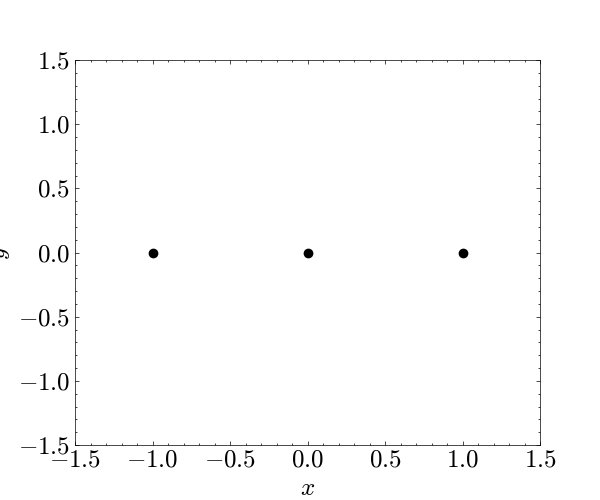

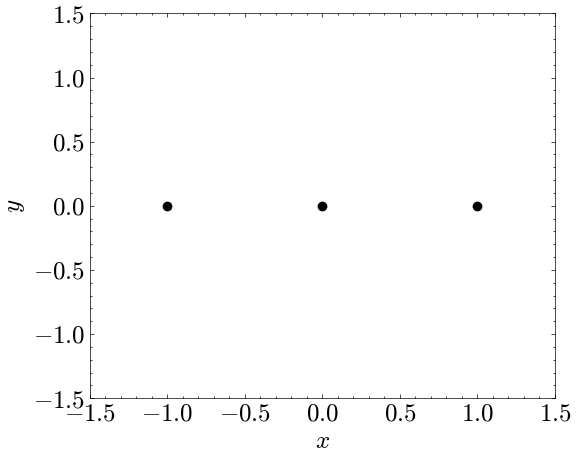

In [ ]:

vx1_0=0.39295      # these specific velocities generate periodicity
vy1_0=0.09758
vx2_0 = vx1_0
vy2_0 = vy1_0
vx3_0 = -2*vx1_0/m3   # ensuring zero net angular momentum
vy3_0 = -2*vy1_0/m3


t = np.linspace(0, 20, 1000)  # dimensionless timespan

#solve using DOP853 and specific rtol,atol
sol = solve_ivp(dSdt, (0,20), y0=[x1_0, y1_0, x2_0, y2_0, x3_0, y3_0,
                    vx1_0, vy1_0, vx2_0, vy2_0, vx3_0, vy3_0],
            method = 'DOP853', t_eval=t, rtol=1e-10, atol=1e-13)

t = sol.t
x1 = sol.y[0]
y1 = sol.y[1]
x2 = sol.y[2]
y2 = sol.y[3]
x3 = sol.y[4]
y3 = sol.y[5]

# generate an animation of the trajectory
def animate(i):
    ln1.set_data([x1[i], x2[i], x3[i]], [y1[i], y2[i], y3[i]])
    tr1.set_data(x1[:i+1], y1[:i+1])
    tr2.set_data(x2[:i+1], y2[:i+1])
    tr3.set_data(x3[:i+1], y3[:i+1])

fig, ax = plt.subplots(figsize=(6,5))
fig.patch.set_facecolor('white')
ax.set_facecolor('white')
ln1, = plt.plot([], [], 'ko', lw=3, markersize=6)
tr1, = plt.plot([], [], 'r--', lw=1)
tr2, = plt.plot([], [], 'g--', lw=1)
tr3, = plt.plot([], [], 'b--', lw=1)
ax.set_ylim(-1.5, 1.5)
ax.set_xlim(-1.5,1.5)
ax.set_ylabel(r'$y$')
ax.set_xlabel(r'$x$')
ani = animation.FuncAnimation(fig, animate, frames=1000, interval=50)
ani.save("butterfly.gif",writer='pillow',fps=30)
display(Image(filename="butterfly.gif"))




# Moth

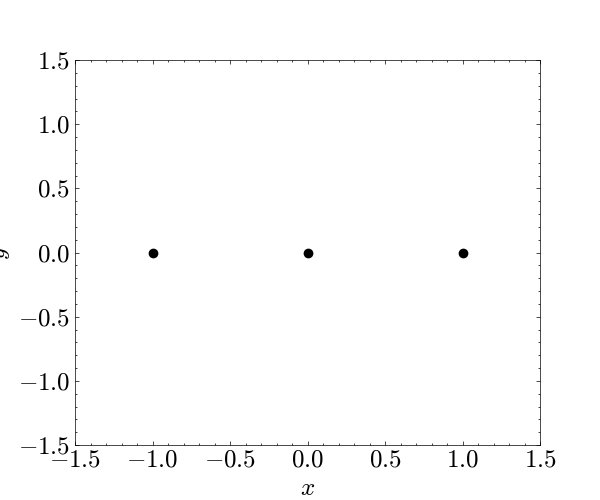

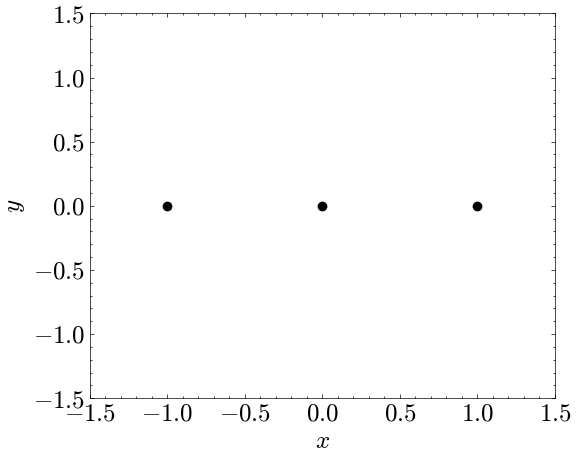

In [ ]:
vx1_0=0.46444     # these specific velocities generate periodicity
vy1_0=0.39606
vx2_0 = vx1_0
vy2_0 = vy1_0
vx3_0 = -2*vx1_0/m3   # ensuring zero net angular momentum
vy3_0 = -2*vy1_0/m3


t = np.linspace(0, 40, 2000)  # dimensionless timespan

#solve using DOP853 and specific rtol,atol
sol = solve_ivp(dSdt, (0,40), y0=[x1_0, y1_0, x2_0, y2_0, x3_0, y3_0,
                    vx1_0, vy1_0, vx2_0, vy2_0, vx3_0, vy3_0],
            method = 'DOP853', t_eval=t, rtol=1e-10, atol=1e-13)

t = sol.t
x1 = sol.y[0]
y1 = sol.y[1]
x2 = sol.y[2]
y2 = sol.y[3]
x3 = sol.y[4]
y3 = sol.y[5]

# generate an animation of the trajectory
def animate(i):
    ln1.set_data([x1[i], x2[i], x3[i]], [y1[i], y2[i], y3[i]])
    tr1.set_data(x1[:i+1], y1[:i+1])
    tr2.set_data(x2[:i+1], y2[:i+1])
    tr3.set_data(x3[:i+1], y3[:i+1])

fig, ax = plt.subplots(figsize=(6,5))
fig.patch.set_facecolor('white')
ax.set_facecolor('white')
ln1, = plt.plot([], [], 'ko', lw=3, markersize=6)
tr1, = plt.plot([], [], 'r--', lw=1)
tr2, = plt.plot([], [], 'g--', lw=1)
tr3, = plt.plot([], [], 'b--', lw=1)
ax.set_ylim(-1.5, 1.5)
ax.set_xlim(-1.5,1.5)
ax.set_ylabel(r'$y$')
ax.set_xlabel(r'$x$')
ani = animation.FuncAnimation(fig, animate, frames=2000, interval=50)
ani.save("moth.gif",writer='pillow',fps=30)
display(Image(filename="moth.gif"))

# Yin Yang

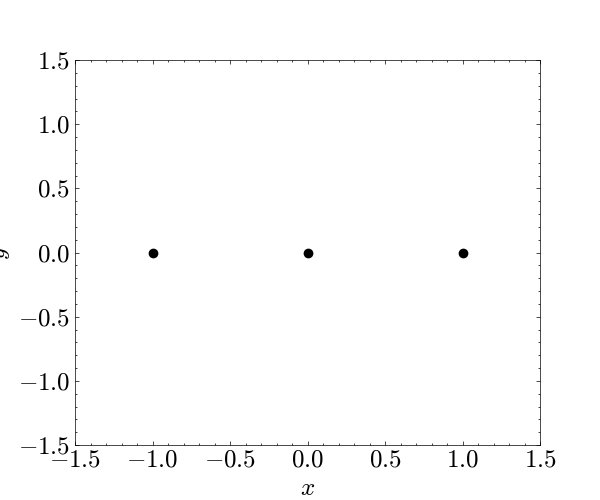

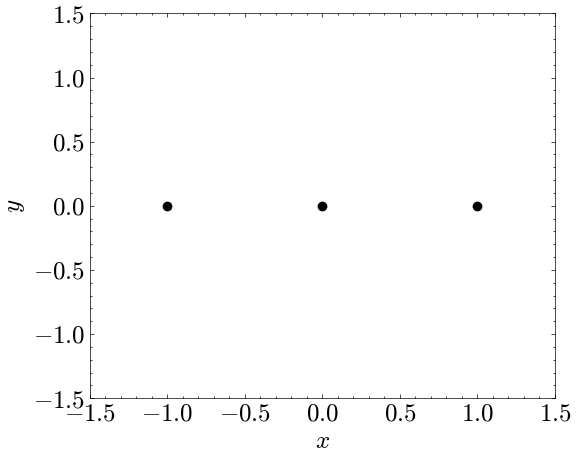

In [ ]:
vx1_0=0.51394     # these specific velocities generate periodicity
vy1_0=0.30474
vx2_0 = vx1_0
vy2_0 = vy1_0
vx3_0 = -2*vx1_0/m3   # ensuring zero net angular momentum
vy3_0 = -2*vy1_0/m3


t = np.linspace(0, 40, 2000)  # dimensionless timespan


#solve using DOP853 and specific rtol,atol
sol = solve_ivp(dSdt, (0,40), y0=[x1_0, y1_0, x2_0, y2_0, x3_0, y3_0,
                    vx1_0, vy1_0, vx2_0, vy2_0, vx3_0, vy3_0],
            method = 'DOP853', t_eval=t, rtol=1e-10, atol=1e-13)

t = sol.t
x1 = sol.y[0]
y1 = sol.y[1]
x2 = sol.y[2]
y2 = sol.y[3]
x3 = sol.y[4]
y3 = sol.y[5]

# generate an animation of the trajectory
def animate(i):
    ln1.set_data([x1[i], x2[i], x3[i]], [y1[i], y2[i], y3[i]])
    tr1.set_data(x1[:i+1], y1[:i+1])
    tr2.set_data(x2[:i+1], y2[:i+1])
    tr3.set_data(x3[:i+1], y3[:i+1])

fig, ax = plt.subplots(figsize=(6,5))
fig.patch.set_facecolor('white')
ax.set_facecolor('white')
ln1, = plt.plot([], [], 'ko', lw=3, markersize=6)
tr1, = plt.plot([], [], 'r--', lw=1)
tr2, = plt.plot([], [], 'g--', lw=1)
tr3, = plt.plot([], [], 'b--', lw=1)
ax.set_ylim(-1.5, 1.5)
ax.set_xlim(-1.5,1.5)
ax.set_ylabel(r'$y$')
ax.set_xlabel(r'$x$')
ani = animation.FuncAnimation(fig, animate, frames=2000, interval=50)
ani.save("yinyang.gif",writer='pillow',fps=30)
display(Image(filename="yinyang.gif"))


In [ ]:
def poincare_map(sol,k):

    crossings = []
    for i in range(1, len(sol.t)):
        if np.isclose((sol.y[1,i]), (sol.y[1,k]), atol=0.01):
            crossings.append((sol.y[0, i], sol.y[6, i], sol.t[i]))  # Record (x, x') pairs


    positions, velocities,time = zip(*crossings)

    plt.figure(figsize=(6, 5))
    plt.scatter(positions, velocities, color='darkgreen', s=8)
    plt.xlabel(r"$x$")
    plt.ylabel(r"$v_x$")
    plt.savefig(f"poincare_map_{sol.y[7,35]:.2f}.png", dpi=300)
    plt.show()

# Generate Poincare Section

Poincare sections can be used to display the periodic behaviour of the system. Below is a comparison between Yin Yang solution vs a pertubation of $0.1$ in the initial condition

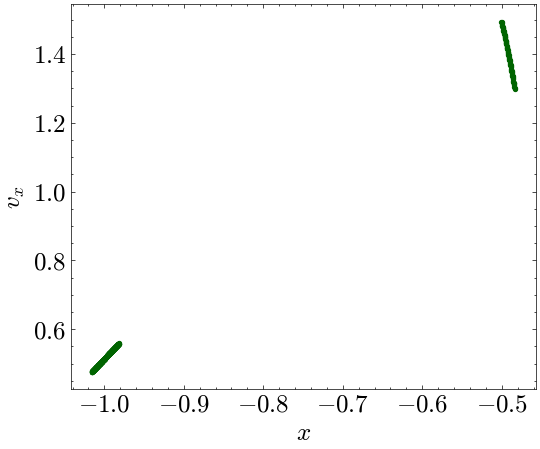

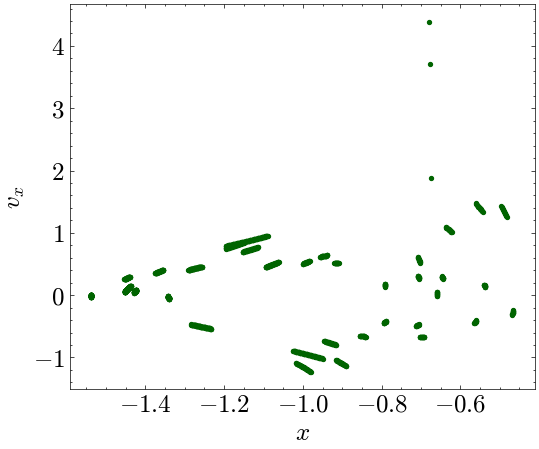

In [ ]:


vx1_0=0.51394     #periodic soln
vy1_0=0.30474

vx12_0=0.50394    #perturbed system
vy12_0=0.31474

vx2_0 = vx1_0
vy2_0 = vy1_0
vx3_0 = -2*vx1_0/m3
vy3_0 = -2*vy1_0/m3


t = np.linspace(0, 100, 100_000)



sol = solve_ivp(dSdt, (0,100), y0=[x1_0, y1_0, x2_0, y2_0, x3_0, y3_0,
                    vx1_0, vy1_0, vx2_0, vy2_0, vx3_0, vy3_0],
            method = 'DOP853', t_eval=t, rtol=1e-13, atol=1e-14)


sol2 = solve_ivp(dSdt, (0,100), y0=[x1_0, y1_0, x2_0, y2_0, x3_0, y3_0,
                    vx12_0, vy12_0, vx2_0, vy2_0, vx3_0, vy3_0],
            method = 'DOP853', t_eval=t, rtol=1e-13, atol=1e-14)

poincare_map(sol,1)
poincare_map(sol2,1)